In [8]:
import matplotlib.pyplot as plt
import librosa.feature
import librosa.display
import numpy as np
from IPython.display import Audio, display
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import ruptures as rpt  # our package
import IPython.display as ipd

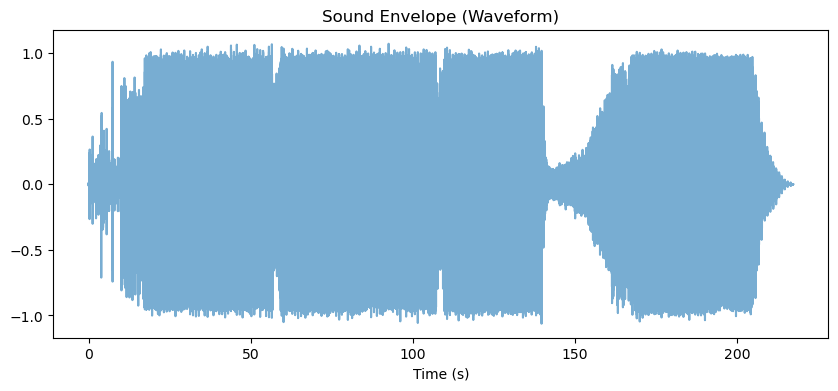

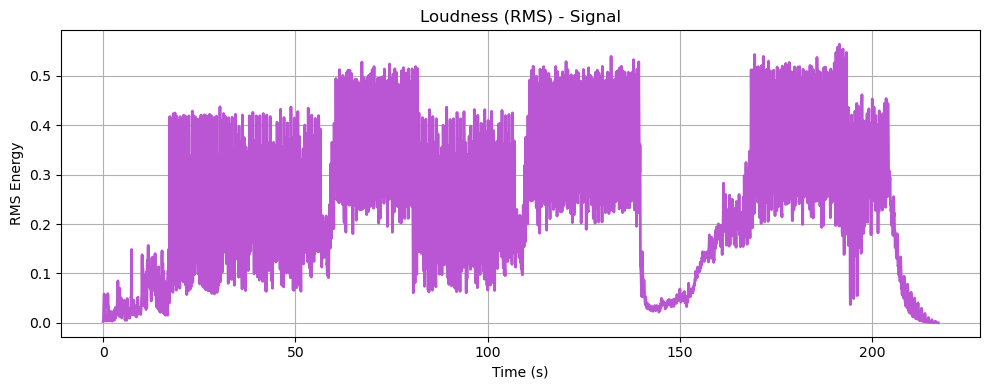

In [9]:
duration = 450  # in seconds
signal, sampling_rate = librosa.load(
    r"C:\Users\anbom\Downloads\Emmanuel songs\03. Vitalic - My Friend Dario.flac", duration=duration)

rms_signal = librosa.feature.rms(y=signal, frame_length=2048, hop_length=512)[0]
times = librosa.frames_to_time(np.arange(len(rms_signal)), sr=sampling_rate, hop_length=512)

# listen to the music
display(Audio(data=signal, rate=sampling_rate))

# Plot waveform
time = np.arange(len(signal)) / sampling_rate
plt.figure(figsize=(10, 4))
plt.plot(time, signal, alpha=0.6)
plt.xlabel("Time (s)")
plt.title("Sound Envelope (Waveform)")
plt.show()

# Plot RMS loudness
plt.figure(figsize=(10, 4))
plt.plot(times, rms_signal, color='mediumorchid', lw=2)
plt.title(f"Loudness (RMS) - Signal")
plt.xlabel("Time (s)")
plt.ylabel("RMS Energy")
plt.grid(True)
plt.tight_layout()
plt.show()


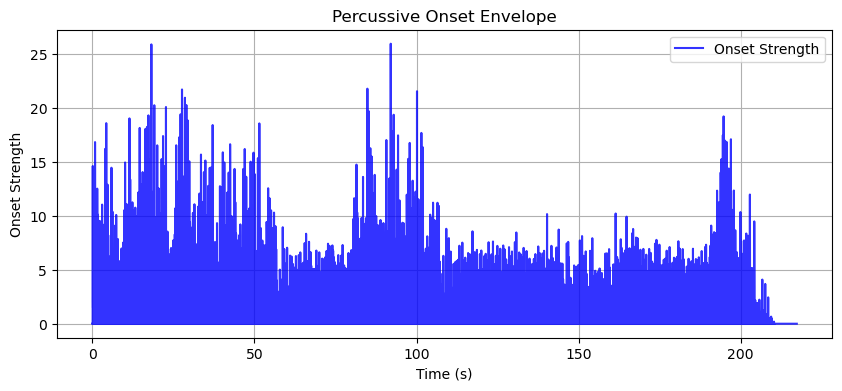

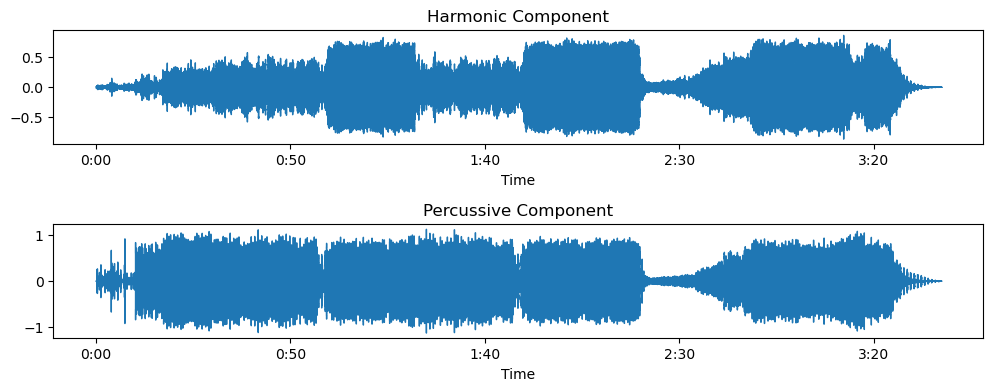

In [3]:
# Enhanced onset strength detection
hop_length_tempo = 512  # long window i guess as others are at 200 ish
y_harmonic, y_percussive = librosa.effects.hpss(signal)  # Separate percussive elements
'''
Okay so the, y_harmonic: harmonics, synth, melodies, if vocals.
y_percussive: percussive parts, drums, snares, hi-hats
'''

# Onset strength detection
oenv = librosa.onset.onset_strength(y=y_percussive, sr=sampling_rate, hop_length=512, aggregate=np.median)
times = librosa.frames_to_time(np.arange(len(oenv)), sr=sampling_rate, hop_length=512)

#viz the oenv
times = librosa.frames_to_time(np.arange(len(oenv)), sr=sampling_rate, hop_length=hop_length_tempo)

# Plot the onset envelope
plt.figure(figsize=(10, 4))
plt.plot(times, oenv, label="Onset Strength", color="blue", alpha=0.8)
plt.xlabel("Time (s)")
plt.ylabel("Onset Strength")
plt.title("Percussive Onset Envelope")
plt.legend()
plt.grid(True)
plt.show()

'''
the peaks in the onset envelope, strong drums
regular hits, kicks snares.
sudden changes, drops / breakdowns
'''

# Display both components
plt.figure(figsize=(12, 4))
plt.subplot(2, 1, 1)
librosa.display.waveshow(y_harmonic, sr=sampling_rate)
plt.title("Harmonic Component")

plt.subplots_adjust(hspace=0.7)

plt.subplot(2, 1, 2)
librosa.display.waveshow(y_percussive, sr=sampling_rate)
plt.title("Percussive Component")
plt.show()


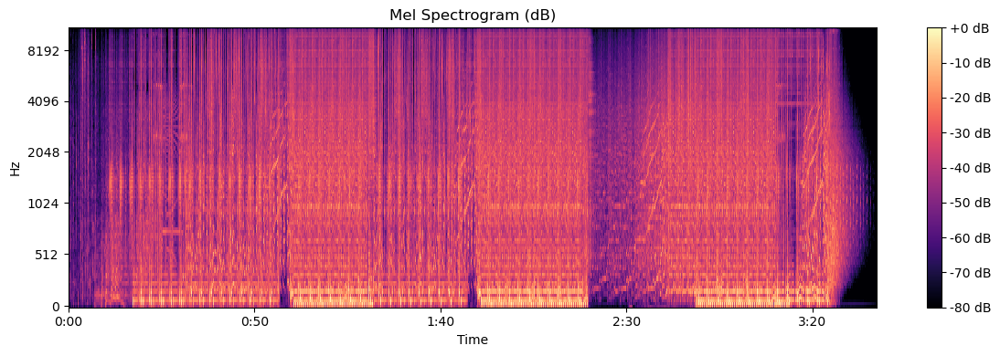

In [4]:
# Compute mel spectrogram and convert to dB
spectrogram = librosa.feature.melspectrogram(y=signal, sr=sampling_rate, hop_length=512, n_fft=2048, n_mels=128)
spectrogram_db = librosa.power_to_db(spectrogram, ref=np.max)

# Plot
plt.figure(figsize=(12, 4))
librosa.display.specshow(spectrogram_db, sr=sampling_rate, hop_length=512, x_axis='time', y_axis='mel', cmap='magma')
plt.colorbar(format="%+2.0f dB")
plt.title("Mel Spectrogram (dB)")
plt.tight_layout()
plt.show()


In [5]:
# Kernel change point detection from ruptures.
# changes in rhythem energy, texture, tempo, instrumentation.
algo = rpt.KernelCPD(kernel="rbf").fit(spectrogram_db.T)
bkps = algo.predict(n_bkps=min(12, spectrogram_db.shape[1] // 5))
# Convert frame indices to time
bkps_times = librosa.frames_to_time(bkps, sr=sampling_rate, hop_length=512)

# Ensure segments are at least 3 seconds apart
min_segment_length = 5  # in seconds
filtered_bkps_times = [bkps_times[0]]  # Always keep the first change point
for b in bkps_times[1:]:
    if b - filtered_bkps_times[-1] >= min_segment_length:
        filtered_bkps_times.append(b)

# Ensure the final segment reaches the end
if filtered_bkps_times[-1] != bkps_times[-1]:
    filtered_bkps_times.append(bkps_times[-1])

# Use filtered breakpoints
bkps_times = np.array(filtered_bkps_times)
print(bkps_times)


[ 10.07746032  17.74004535  59.16444444  80.38748299 109.92326531
 139.83056689 154.15727891 168.11247166 190.21786848 197.36961451
 207.37741497 213.06630385 217.2923356 ]


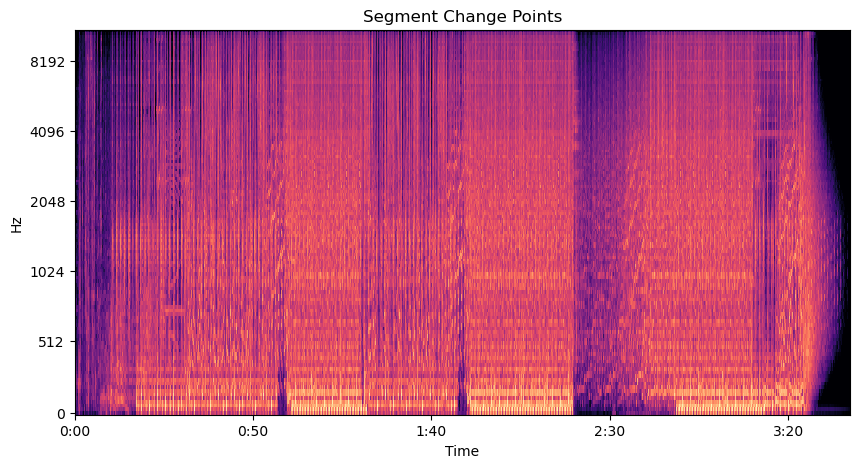

Change detected at: 10.08 seconds
Change detected at: 17.74 seconds
Change detected at: 59.16 seconds
Change detected at: 80.39 seconds
Change detected at: 109.92 seconds
Change detected at: 139.83 seconds
Change detected at: 154.16 seconds
Change detected at: 168.11 seconds
Change detected at: 190.22 seconds
Change detected at: 197.37 seconds
Change detected at: 207.38 seconds
Change detected at: 213.07 seconds
Segment 1: 0.00s - 10.08s (Duration: 10.08s)
Segment 2: 10.08s - 17.74s (Duration: 7.66s)
Segment 3: 17.74s - 59.16s (Duration: 41.42s)
Segment 4: 59.16s - 80.39s (Duration: 21.22s)
Segment 5: 80.39s - 109.92s (Duration: 29.54s)
Segment 6: 109.92s - 139.83s (Duration: 29.91s)
Segment 7: 139.83s - 154.16s (Duration: 14.33s)
Segment 8: 154.16s - 168.11s (Duration: 13.96s)
Segment 9: 168.11s - 190.22s (Duration: 22.11s)
Segment 10: 190.22s - 197.37s (Duration: 7.15s)
Segment 11: 197.37s - 207.38s (Duration: 10.01s)
Segment 12: 207.38s - 213.07s (Duration: 5.69s)
Segment 13: 213.07

In [6]:
# Visuals of detected changes
fig, ax = plt.subplots(figsize=(10, 5))
librosa.display.specshow(spectrogram_db, ax=ax, hop_length=hop_length_tempo, sr=sampling_rate, x_axis="time", y_axis="mel")
ax.set_title("Segment Change Points")
plt.show()

for b in bkps_times[:-1]:
    ax.axvline(b, ls="--", color="red", lw=2)
    print(f"Change detected at: {b:.2f} seconds")


# Extract segments and display their timestamps
bkps_time_indexes = (sampling_rate * bkps_times).astype(int).tolist()

# store the segments into an array for later
audio_segments = []

for segment_number, (start, end) in enumerate(rpt.utils.pairwise([0] + bkps_time_indexes), start=1):
    start_time = start / sampling_rate
    end_time = end / sampling_rate
    duration = (end - start) / sampling_rate

    segment_audio = signal[start:end]  # Extract segments
    audio_segments.append(segment_audio)

    print(f"Segment {segment_number}: {start_time:.2f}s - {end_time:.2f}s (Duration: {duration:.2f}s)")
    # display(Audio(data=signal[start:end], rate=sampling_rate))

print("number of segments: {}".format(len(audio_segments)))


13


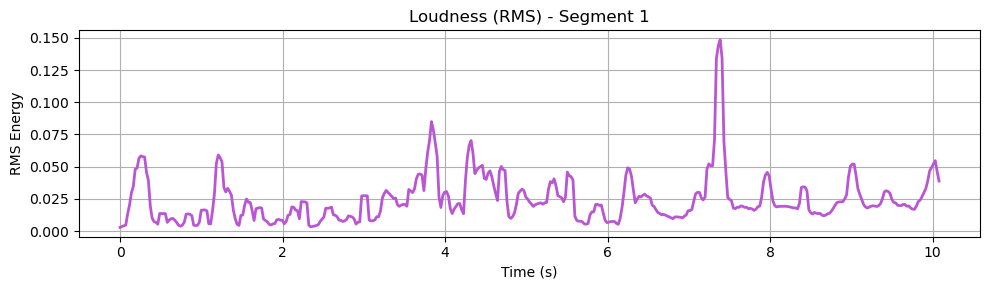

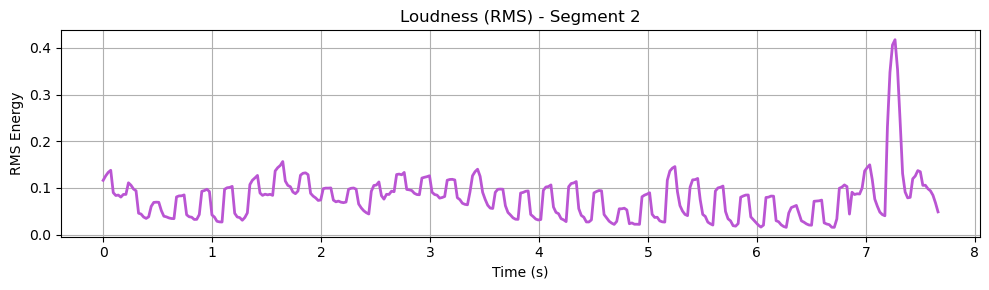

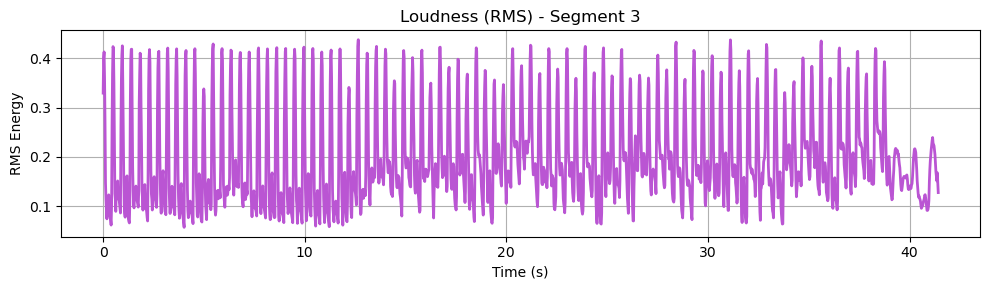

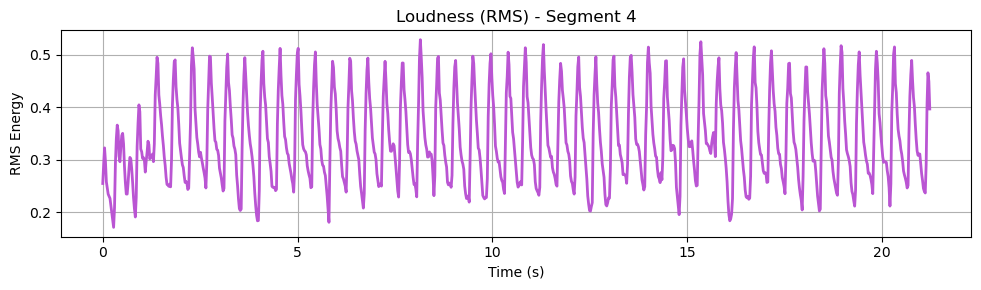

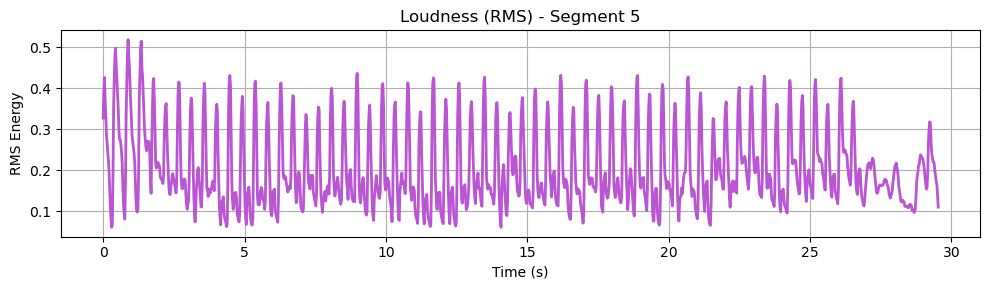

...

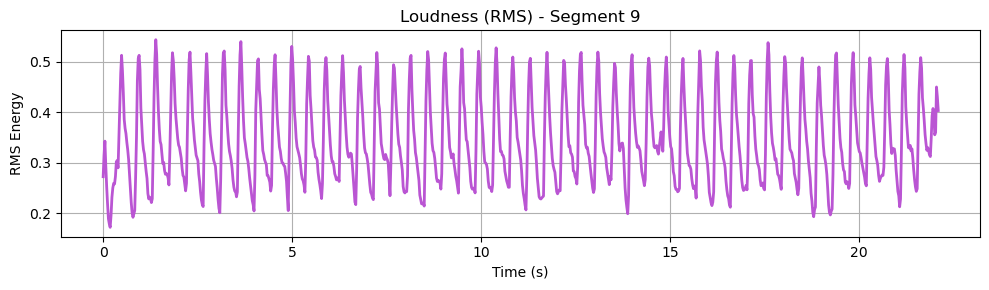

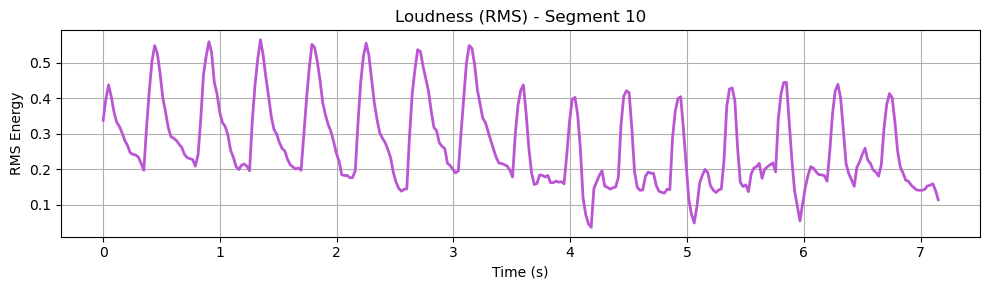

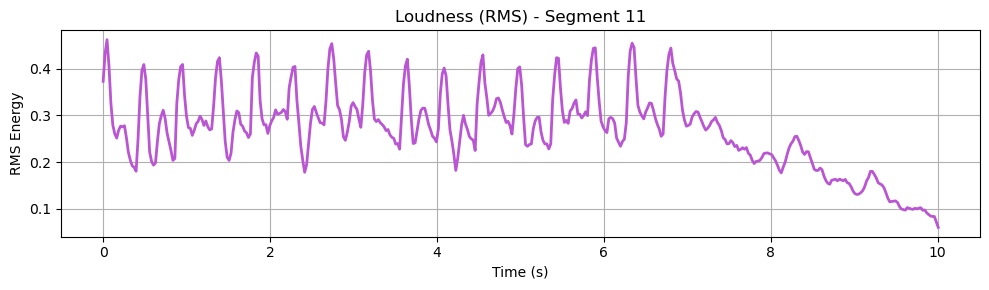

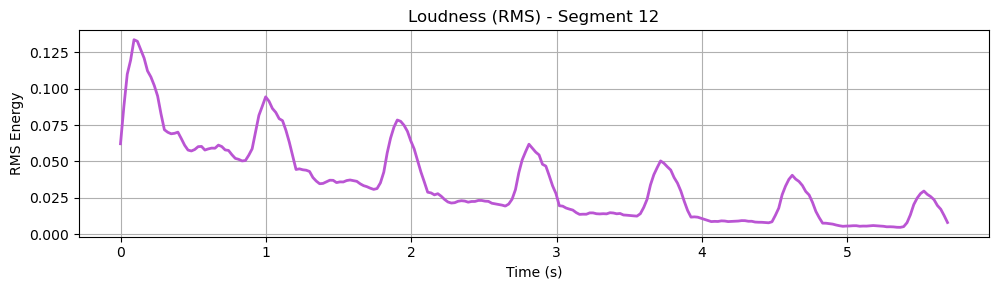

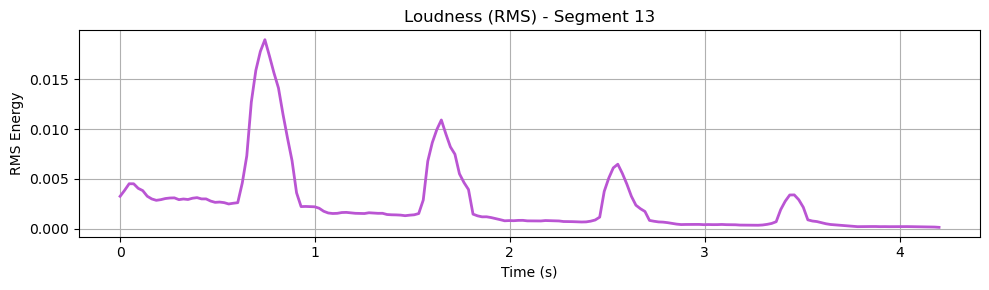

In [7]:
# see if the audio is loaded in
print(len(audio_segments))
# print(audio_segments)

# frame rate sample?
Fs = 22050

# load the files :)
X_wav = audio_segments[0]


# Loudness (RMS Energy) per Segment
N = 2048   # Frame length (window size)
H = 512    # Hop length

for i, segment in enumerate(audio_segments):
    rms_segments = librosa.feature.rms(y=segment, frame_length=N, hop_length=H)[0]
    times = librosa.frames_to_time(np.arange(len(rms_segments)), sr=sampling_rate, hop_length=H)

    # Plot RMS loudness
    plt.figure(figsize=(10, 3))
    plt.plot(times, rms_segments, color='mediumorchid', lw=2)
    plt.title(f"Loudness (RMS) - Segment {i+1}")
    plt.xlabel("Time (s)")
    plt.ylabel("RMS Energy")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Play the segment (optional)
    display(Audio(data=segment, rate=sampling_rate))
